# Ensemble 4: gravity spacings vs noise; high-strength regional field

import packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
import itertools
import logging
import os
import pathlib
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pygmt
import verde as vd
import xarray as xr
from polartoolkit import maps
from polartoolkit import utils as polar_utils
from tqdm.autonotebook import tqdm

import synthetic_bathymetry_inversion.plotting as synth_plotting
from synthetic_bathymetry_inversion import synthetic

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, optimization, plotting, regional, utils
from invert4geom import synthetic as inv_synthetic

/home/mattd/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/esmpy/interface/loadESMF.py:94: VersionWarning:

ESMF installation version 8.8.0, ESMPy version 8.8.0b0



In [2]:
ensemble_path = "../results/Ross_Sea/ensembles/Ross_Sea_ensemble_04_grav_spacing_vs_noise_0_3_strong_regional_with_density_estimation"
ensemble_fname = f"{ensemble_path}.csv"

INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:spacing larger than original, filtering and resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


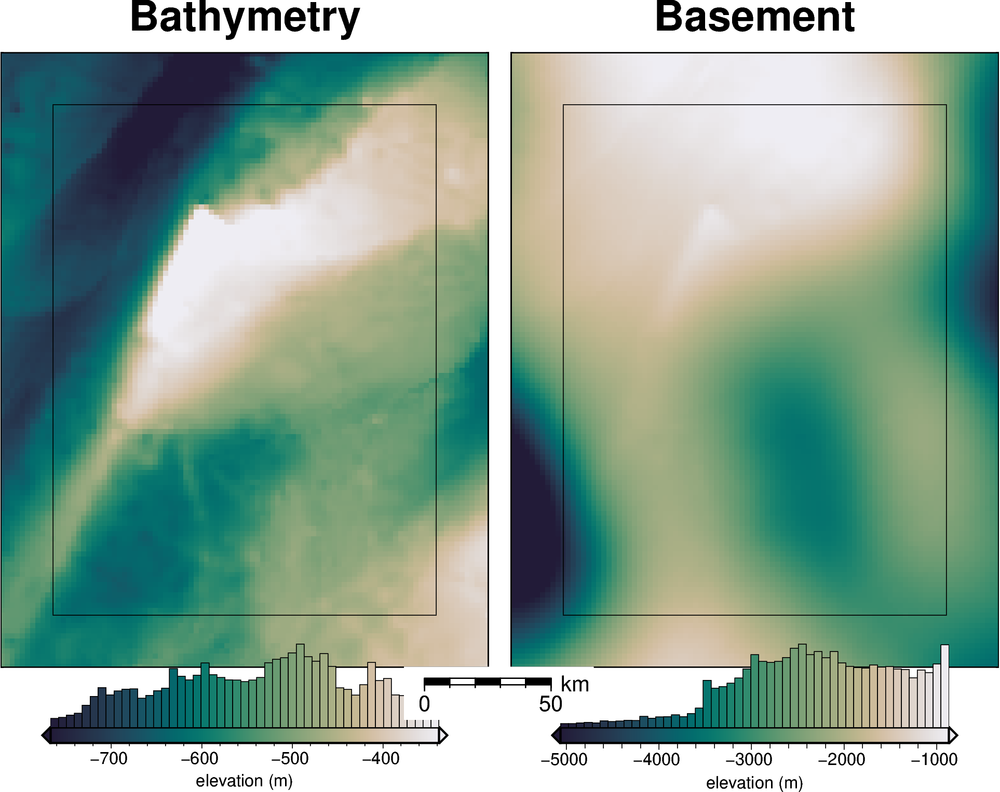

  0%|          | 0/7676 [00:00<?, ?it/s]

  0%|          | 0/7676 [00:00<?, ?it/s]

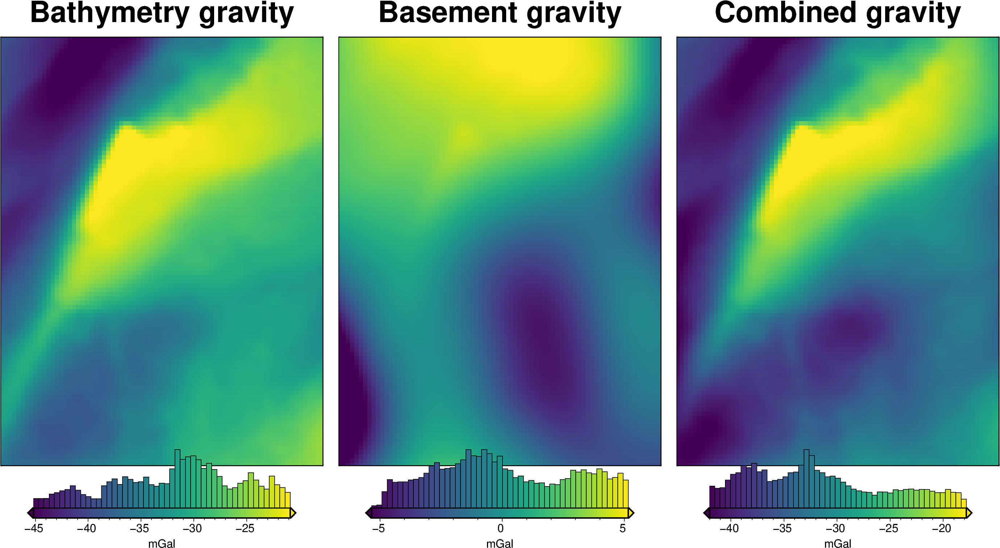

In [3]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, _, original_grav_df = synthetic.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

In [4]:
bathymetry = bathymetry.sel(
    easting=slice(inversion_region[0], inversion_region[1]),
    northing=slice(inversion_region[2], inversion_region[3]),
)

In [5]:
# normalize regional gravity between -1 and 1
original_grav_df["basement_grav_normalized"] = (
    vd.grid_to_table(
        utils.normalize_xarray(
            original_grav_df.set_index(["northing", "easting"])
            .to_xarray()
            .basement_grav,
            low=-1,
            high=1,
        )
    )
    .reset_index()
    .basement_grav
)
original_grav_df = original_grav_df.drop(
    columns=["basement_grav", "disturbance", "gravity_anomaly"]
)
original_grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951
...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841


In [6]:
# re-scale the regional gravity
regional_grav = utils.normalize_xarray(
    original_grav_df.set_index(["northing", "easting"])
    .to_xarray()
    .basement_grav_normalized,
    low=0,
    # high=100, # gives stdev of 20 mGal
    # high=150, # gives stdev of 31 mGal
    high=200,  # gives stdev of 41 mGal
).rename("basement_grav")
regional_grav -= regional_grav.mean()

# add to dataframe
original_grav_df["basement_grav"] = (
    vd.grid_to_table(regional_grav).reset_index().basement_grav
)

# add basement and bathymetry forward gravities together to make observed gravity
original_grav_df["gravity_anomaly_full_res_no_noise"] = (
    original_grav_df.bathymetry_grav + original_grav_df.basement_grav
)

new_reg = original_grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav
new_reg -= new_reg.mean()
utils.rmse(new_reg)

40.913189143754835

In [7]:
original_grav_df["basement_grav"].std()

40.915854411282744

In [8]:
# semi-regularly spaced
constraint_points = synthetic.constraint_layout_number(
    shape=(6, 7),
    region=inversion_region,
    padding=-spacing,
    shapefile="../results/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points.head()

,northing,easting,inside,true_upward,upward
0,-1600000.0,-40000.0,False,-601.093811,-601.093811
1,-1600000.0,-38000.0,False,-609.216797,-609.216797
2,-1600000.0,-36000.0,False,-616.356018,-616.356018
3,-1600000.0,-34000.0,False,-621.262207,-621.262207
4,-1600000.0,-32000.0,False,-625.510864,-625.510864


In [9]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.24376756, -544.57145532, -547.92259611, ..., -360.00002858,
        -357.06763298, -354.19952961],
       [-543.34365606, -546.81640129, -550.35222196, ..., -362.90249581,
        -359.9686979 , -357.11426816],
       [-545.05496589, -548.66001145, -552.37483947, ..., -365.66133989,
        -362.73264883, -359.9004747 ],
       ...,
       [-591.95330238, -595.5187825 , -599.06866788, ..., -440.89364102,
        -440.6949685 , -440.40606698],
       [-590.53129825, -594.09072645, -597.64076241, ..., -440.69206448,
        -440.42575788, -440.07250027],
       [-589.16627634, -592.73500682, -596.3020645 , ..., -440.51808973,
        -440.17189745, -439.74486709]])
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [10]:
inner_starting_bathymetry = starting_bathymetry.sel(
    easting=slice(inversion_region[0], inversion_region[1]),
    northing=slice(inversion_region[2], inversion_region[3]),
)

starting_bathymetry_rmse = utils.rmse(bathymetry - inner_starting_bathymetry)

In [11]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.starting_bathymetry)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.03 m


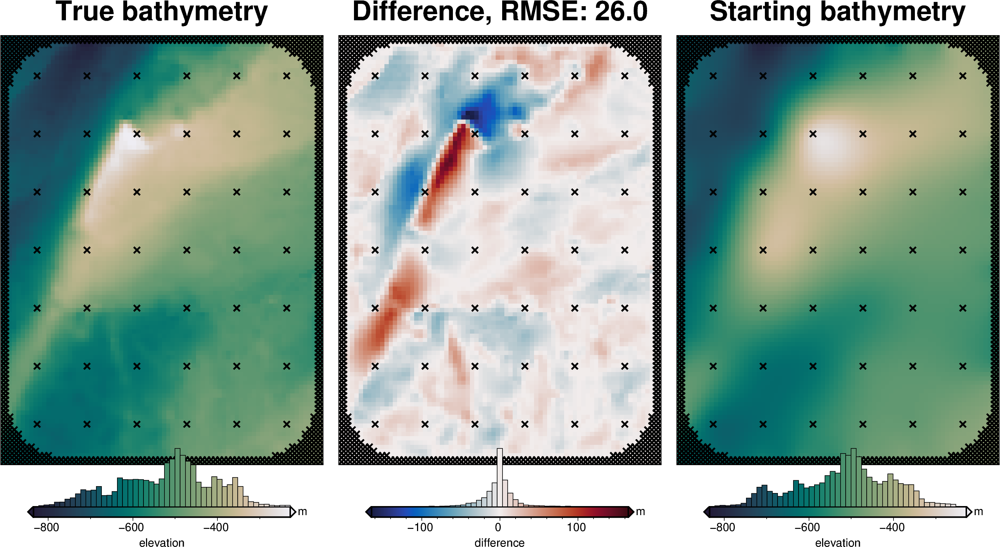

In [12]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    cbar_yoffset=1,
    label_font="16p,Helvetica,black",
    points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    points_style="x.2c",
)

In [13]:
# the true density contrast is 1476 kg/m3
density_contrast = 1476

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

original_grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        original_grav_df.easting,
        original_grav_df.northing,
        original_grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

original_grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-80.664303,-116.215344,-35.578552
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-75.432916,-111.487569,-36.042636
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-69.753912,-106.227060,-36.460093
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-63.723467,-100.479079,-36.784646
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-57.439345,-94.390377,-36.998466
...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,16.866303,-8.894077,-25.498181
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,10.432774,-15.478956,-25.673783
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,3.832943,-22.200184,-25.808796
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-2.860205,-28.982436,-25.904539


# Set line spacings and noise levels

In [14]:
num = 10

# Define number of flights lines on log scale
grav_line_numbers = np.unique(np.round(np.geomspace(3, 30, num)))
grav_line_numbers = [int(i) for i in grav_line_numbers]
assert len(grav_line_numbers) == num

# Define noise levels for grav data
grav_noise_levels = [float(round(x, 2)) for x in np.linspace(0, 3, num)]

print("number of grav lines:", grav_line_numbers)
print("grav noise levels:", grav_noise_levels)

number of grav lines: [3, 4, 5, 6, 8, 11, 14, 18, 23, 30]
grav noise levels: [0.0, 0.33, 0.67, 1.0, 1.33, 1.67, 2.0, 2.33, 2.67, 3.0]


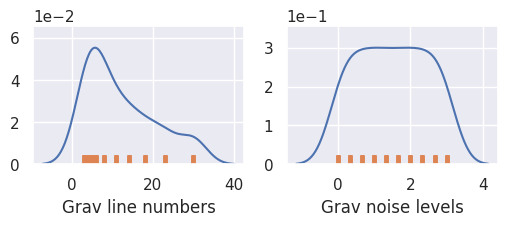

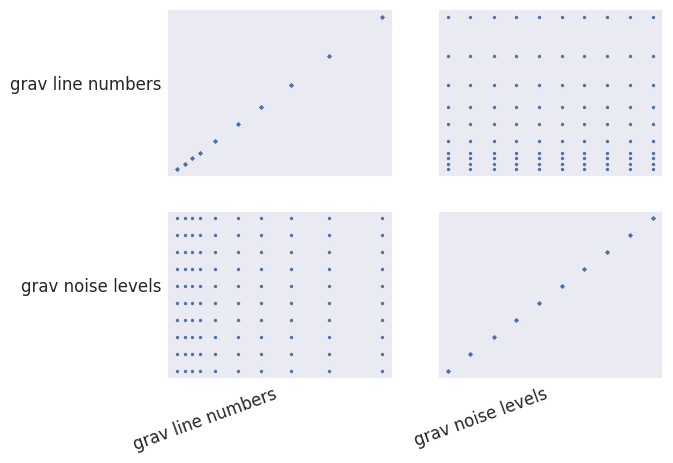

In [15]:
# turn into dataframe
sampled_params_df = pd.DataFrame(
    itertools.product(
        grav_line_numbers,
        grav_noise_levels,
    ),
    columns=[
        "grav_line_numbers",
        "grav_noise_levels",
    ],
)

sampled_params_dict = dict(
    grav_line_numbers=dict(sampled_values=sampled_params_df.grav_line_numbers),
    grav_noise_levels=dict(sampled_values=sampled_params_df.grav_noise_levels),
)

plotting.plot_latin_hypercube(
    sampled_params_dict,
)

In [16]:
sampled_params_df

,grav_line_numbers,grav_noise_levels
0,3,0.00
1,3,0.33
2,3,0.67
3,3,1.00
4,3,1.33
...,...,...
95,30,1.67
96,30,2.00
97,30,2.33
98,30,2.67


# Contaminate gravity with noise

In [17]:
# fnames to save files for each ensemble
sampled_params_df["grav_df_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names, add to dataframe
    sampled_params_df.loc[i, "grav_df_fname"] = f"{ensemble_path}_grav_df_{i}.csv"

  0%|          | 0/100 [00:00<?, ?it/s]

In [18]:
grav_grid = original_grav_df.set_index(["northing", "easting"]).to_xarray()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    grav_df = original_grav_df.copy()

    # contaminated with long-wavelength noise
    grav_df["gravity_anomaly_full_res"] = grav_df.gravity_anomaly_full_res_no_noise
    with utils._log_level(logging.ERROR):
        contaminated = inv_synthetic.contaminate_with_long_wavelength_noise(
            grav_grid.gravity_anomaly_full_res_no_noise,
            coarsen_factor=None,
            spacing=2e3,
            noise_as_percent=False,
            noise=row.grav_noise_levels,
        )
    contaminated_df = vd.grid_to_table(
        contaminated.rename("gravity_anomaly_full_res")
    ).reset_index(drop=True)

    grav_df = pd.merge(  # noqa: PD015
        grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
        contaminated_df,
        on=["easting", "northing"],
    )

    # # short-wavelength noise
    # with utils._log_level(logging.ERROR):
    #     contaminated = synthetic.contaminate_with_long_wavelength_noise(
    #         grav_df.set_index(["northing", "easting"])
    #         .to_xarray()
    #         .gravity_anomaly_full_res,
    #         coarsen_factor=None,
    #         spacing=spacing * 2,
    #         noise_as_percent=False,
    #         noise=row.grav_noise_levels,
    #     )
    # contaminated_df = vd.grid_to_table(
    #     contaminated.rename("gravity_anomaly_full_res")
    # ).reset_index(drop=True)

    # grav_df = pd.merge(
    #     grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
    #     contaminated_df,
    #     on=["easting", "northing"],
    # )

    # add noise level to uncert column
    grav_df["uncert"] = row.grav_noise_levels

    # save to files
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning original grid
INFO:polartoolkit:returning origin

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [19]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [20]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


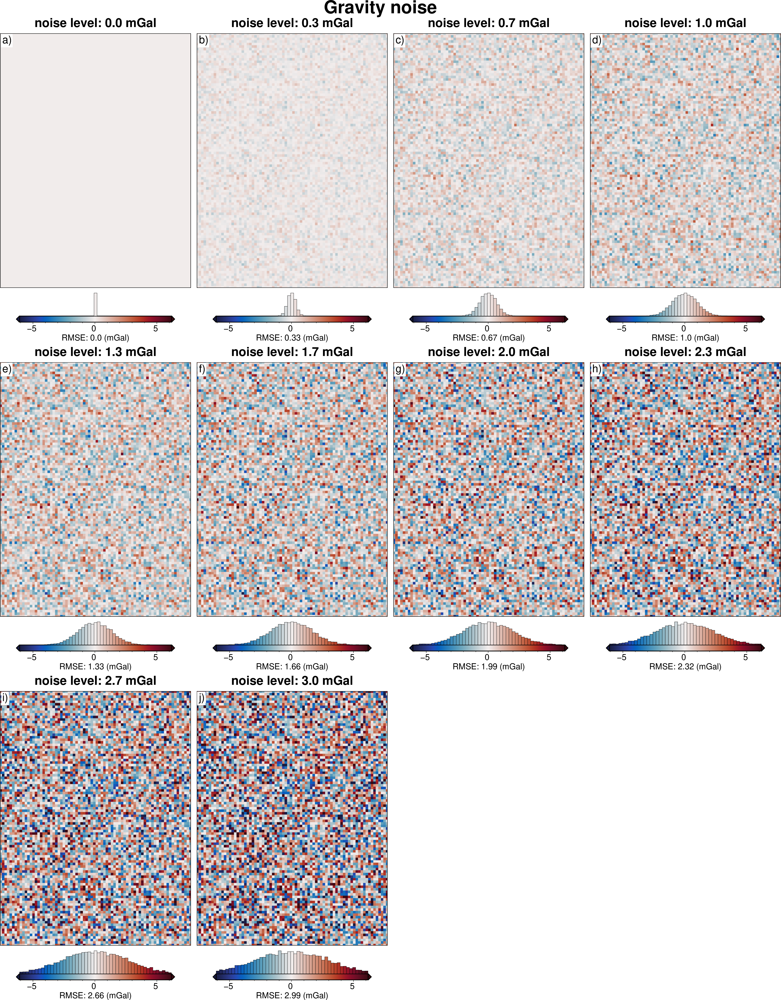

In [21]:
# subplots showing grav data loss from sampling
grids = []
titles = []
cbar_labels = []
for i, row in sampled_params_df.iterrows():
    if i < num:
        grav_df = pd.read_csv(row.grav_df_fname)
        grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
        dif = (
            grav_grid.gravity_anomaly_full_res_no_noise
            - grav_grid.gravity_anomaly_full_res
        )
        # add to lists
        grids.append(dif)
        titles.append(f"noise level: {round(row.grav_noise_levels,1)} mGal")
        cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")

fig = maps.subplots(
    grids,
    fig_title="Gravity noise",
    titles=titles,
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
)

fig.show()

# Sample along flightlines

In [22]:
# fnames to save files for each ensemble
sampled_params_df["grav_survey_df_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names, add to dataframe
    sampled_params_df.loc[i, "grav_survey_df_fname"] = (
        f"{ensemble_path}_grav_survey_df_{i}.csv"
    )

  0%|          | 0/100 [00:00<?, ?it/s]

In [23]:
logging.getLogger().setLevel(logging.WARNING)

# add empty columns
# average of the east/west and north/south line spacings
sampled_params_df["grav_line_spacing"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # create flight lines
    grav_survey_df = synthetic.airborne_survey(
        along_line_spacing=500,
        grav_observation_height=1e3,
        ns_line_number=row.grav_line_numbers,
        ew_line_number=row.grav_line_numbers,
        region=inversion_region,
        grav_grid=grav_df.set_index(["northing", "easting"])
        .to_xarray()
        .gravity_anomaly_full_res,
        plot=False,
    )
    x_spacing = (inversion_region[1] - inversion_region[0]) / row.grav_line_numbers
    y_spacing = (inversion_region[3] - inversion_region[2]) / row.grav_line_numbers
    grav_line_spacing = ((x_spacing + y_spacing) / 2) / 1e3

    # sample no-noise grid onto survey lines
    grav_survey_df = utils.sample_grids(
        grav_survey_df,
        grav_df.set_index(
            ["northing", "easting"]
        ).gravity_anomaly_full_res_no_noise.to_xarray(),
        sampled_name="gravity_anomaly_no_noise",
    )

    # add to dataframe
    sampled_params_df.loc[i, "grav_line_spacing"] = grav_line_spacing

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)


sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333
...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333


In [24]:
sampled_params_df["grav_proximity"] = np.nan
for i, row in sampled_params_df.iterrows():
    # load data
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # calc min distance
    coords = vd.grid_coordinates(
        region=inversion_region,
        spacing=100,
    )
    grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z
    min_dist = (
        utils.dist_nearest_points(
            grav_survey_df,
            grid,
        ).min_dist
        / 1e3
    )
    sampled_params_df.loc[i, "grav_proximity"] = min_dist.median()

sampled_params_df.grav_proximity.describe()

count    100.000000
mean       3.430303
std        2.368128
min        0.824621
25%        1.400000
50%        2.704055
75%        5.001000
max        8.333333
Name: grav_proximity, dtype: float64

# Filter flight line data

In [25]:
# add empty columns
sampled_params_df["filter_width_trials_fname"] = np.nan

for i, row in sampled_params_df.iterrows():
    # set file names, add to dataframe
    sampled_params_df.loc[i, "filter_width_trials_fname"] = (
        f"{ensemble_path}_filter_width_trials_{i}.csv"
    )

In [26]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # trial a range of 1D low-pass filters and see which performs best
    dfs = []
    filter_widths = np.arange(0, 50e3, 4e3)
    for f in filter_widths:
        survey_df = grav_survey_df.copy()

        if f == 0:
            survey_df["grav_anomaly_filt"] = survey_df.gravity_anomaly
        else:
            survey_df["grav_anomaly_filt"] = synthetic.filter_flight_lines(
                survey_df,
                data_column="gravity_anomaly",
                filt_type=f"g{f}",
            )

        # compared filtered line data with no-noise line data
        survey_df["dif"] = (
            survey_df.gravity_anomaly_no_noise - survey_df.grav_anomaly_filt
        )

        dfs.append(
            pd.DataFrame(
                [
                    {
                        "filt_width": f,
                        "rmse": utils.rmse(survey_df.dif),
                    }
                ]
            )
        )

    filter_width_trials = pd.concat(dfs, ignore_index=True)

    # save to files
    filter_width_trials.to_csv(row.filter_width_trials_fname, index=False)


sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [27]:
# add empty columns
sampled_params_df["best_filter_width"] = np.nan

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    filter_width_trials = pd.read_csv(row.filter_width_trials_fname)

    best_ind = filter_width_trials.rmse.idxmin()
    best_filter_width = filter_width_trials.iloc[best_ind].filt_width

    sampled_params_df.loc[i, "best_filter_width"] = best_filter_width

sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0
...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0


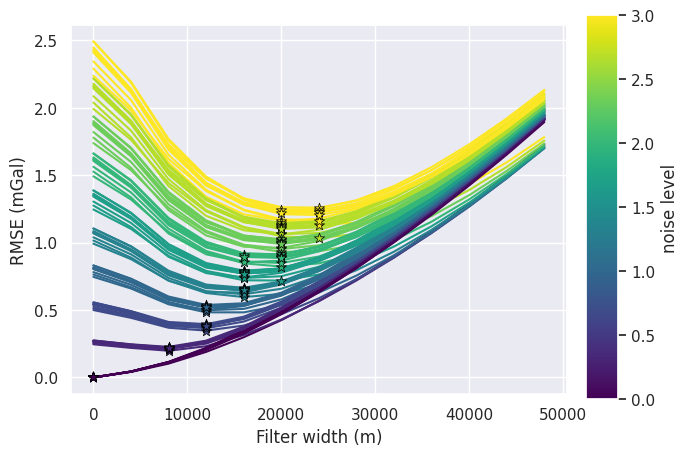

In [28]:
df = sampled_params_df.copy()
# df = df[df.grav_line_spacing == 35]
norm = plt.Normalize(
    vmin=df.grav_noise_levels.values.min(),
    vmax=df.grav_noise_levels.values.max(),
)

fig, ax = plt.subplots()

for i, row in df.iterrows():
    # load data
    filter_width_trials = pd.read_csv(row.filter_width_trials_fname)

    best_ind = filter_width_trials.rmse.idxmin()

    ax.plot(
        filter_width_trials.filt_width,
        filter_width_trials.rmse,
        color=plt.cm.viridis(norm(row.grav_noise_levels)),  # pylint: disable=no-member
    )
    ax.set_xlabel("Filter width (m)")
    ax.set_ylabel("RMSE (mGal)")
    ax.scatter(
        # x=filter_width_trials.filt_width.iloc[best_ind],
        x=row.best_filter_width,
        y=filter_width_trials.rmse.iloc[best_ind],
        marker="*",
        edgecolor="black",
        linewidth=0.5,
        color=plt.cm.viridis(norm(row.grav_noise_levels)),  # pylint: disable=no-member
        s=60,
        zorder=20,
    )

sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
cax = fig.add_axes([0.93, 0.1, 0.05, 0.8])
cbar = plt.colorbar(sm, cax=cax)
cbar.set_label("noise level")

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0
...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0


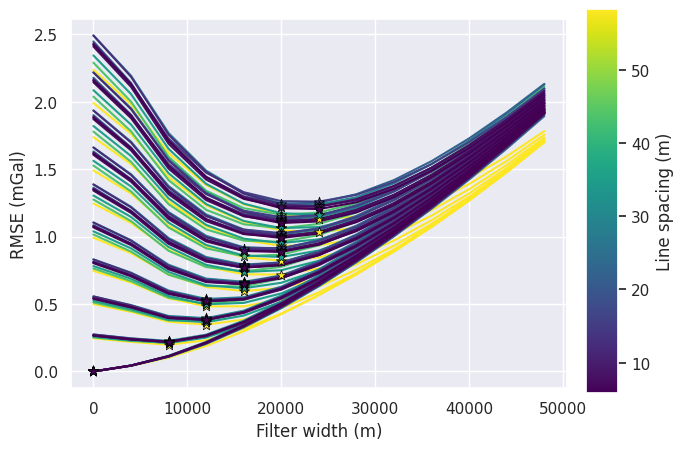

In [29]:
# variable = grav_noise_levels
# title = "Gravity noise (mGal)"

variable = "grav_line_spacing"
title = "Line spacing (m)"

norm = plt.Normalize(
    vmin=sampled_params_df[variable].values.min(),
    vmax=sampled_params_df[variable].values.max(),
)
for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    filter_width_trials = pd.read_csv(row.filter_width_trials_fname)

    best_ind = filter_width_trials.rmse.idxmin()
    best_filter_width = filter_width_trials.iloc[best_ind].filt_width

    if i == 0:
        fig, ax = plt.subplots()

    ax.plot(
        filter_width_trials.filt_width,
        filter_width_trials.rmse,
        color=plt.cm.viridis(norm(row[variable])),  # pylint: disable=no-member
    )
    ax.set_xlabel("Filter width (m)")
    ax.set_ylabel("RMSE (mGal)")
    ax.scatter(
        x=filter_width_trials.filt_width.iloc[best_ind],
        y=filter_width_trials.rmse.iloc[best_ind],
        marker="*",
        edgecolor="black",
        linewidth=0.5,
        color=plt.cm.viridis(norm(row[variable])),  # pylint: disable=no-member
        s=60,
        zorder=20,
    )

sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
cax = fig.add_axes([0.93, 0.1, 0.05, 0.8])
cbar = plt.colorbar(sm, cax=cax)
cbar.set_label(title)

sampled_params_df

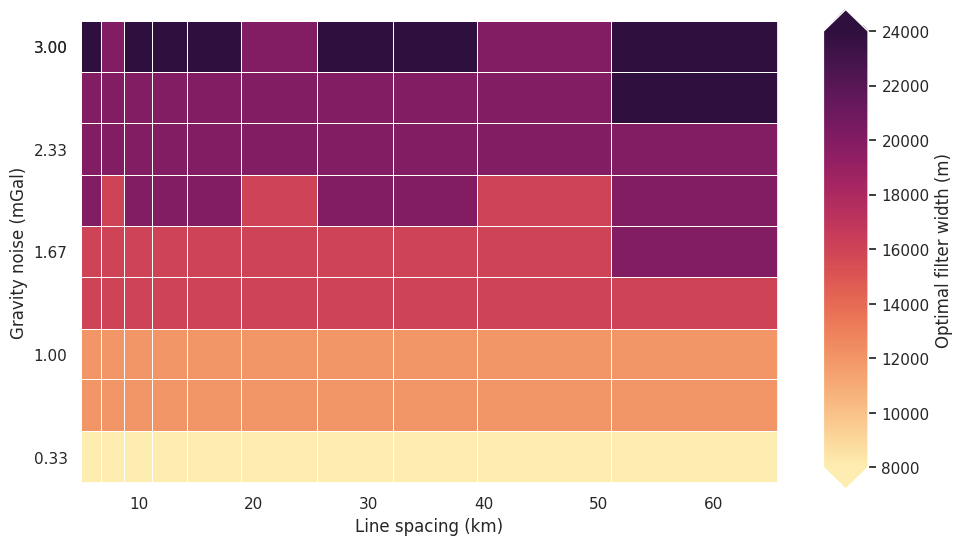

In [30]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df[sampled_params_df.grav_noise_levels > 0],
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="best_filter_width",
    background_title="Optimal filter width (m)",
    background_robust=True,
    constrained_layout=False,
)

<Axes: ylabel='Frequency'>

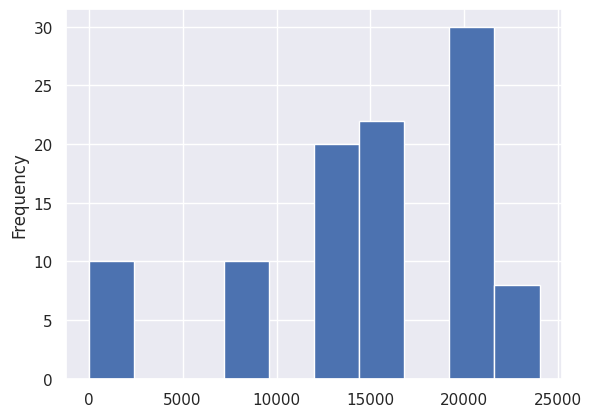

In [31]:
sampled_params_df.best_filter_width.plot.hist()

In [32]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    # filter each line in 1D with a Gaussian filter to remove some noise
    if row.best_filter_width == 0:
        grav_survey_df["gravity_anomaly"] = grav_survey_df.gravity_anomaly
    else:
        grav_survey_df["gravity_anomaly"] = synthetic.filter_flight_lines(
            grav_survey_df,
            data_column="gravity_anomaly",
            filt_type=f"g{row.best_filter_width}",
        )

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)

  0%|          | 0/100 [00:00<?, ?it/s]

# Interpolate flight line data

In [33]:
logging.getLogger().setLevel(logging.WARNING)

# add empty columns
sampled_params_df["grav_data_loss_rmse"] = np.nan
sampled_params_df["grav_data_loss_mae"] = np.nan

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)

    grav_grid = pygmt.surface(
        data=grav_survey_df[["easting", "northing", "gravity_anomaly"]],
        region=inversion_region,
        spacing=spacing,
        tension=0.25,
        verbose="q",
    )
    grav_df = utils.sample_grids(
        grav_df,
        grav_grid,
        sampled_name="gravity_anomaly",
    )

    # add to dataframe
    dif = grav_df.gravity_anomaly_full_res_no_noise - grav_df.gravity_anomaly
    sampled_params_df.loc[i, "grav_data_loss_rmse"] = float(utils.rmse(dif))
    sampled_params_df.loc[i, "grav_data_loss_mae"] = float(np.abs(dif).mean())

    # save to files
    grav_survey_df.to_csv(row.grav_survey_df_fname, index=False)
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090
...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,0.814961,0.580565
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,0.937147,0.658105
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.016720,0.731753
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.103661,0.809328


In [34]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [35]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090


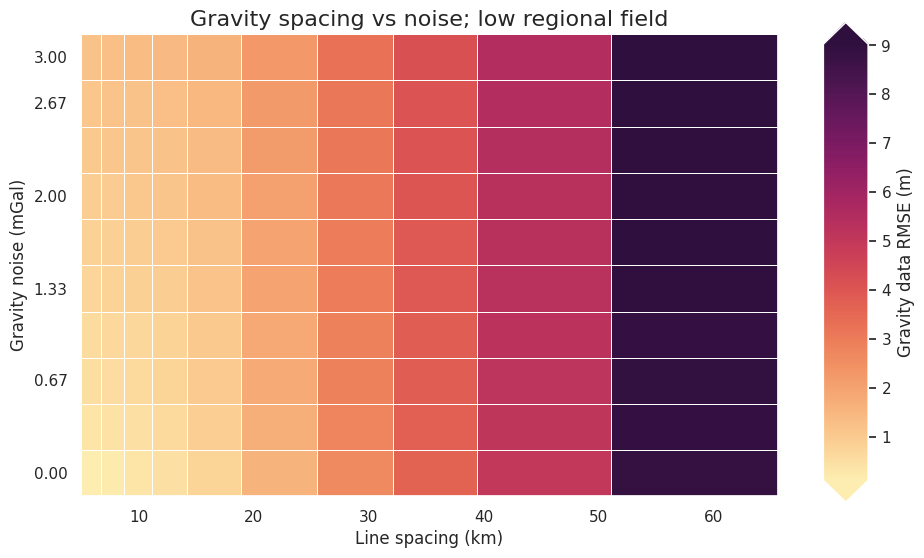

In [36]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="grav_data_loss_rmse",
    background_title="Gravity data RMSE (m)",
    plot_title="Gravity spacing vs noise; low regional field",
    constrained_layout=False,
)

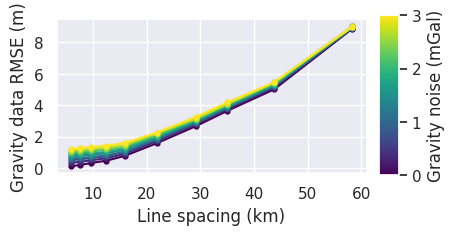

In [37]:
x = "grav_line_spacing"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(4, 2),
    x=x,
    x_label="Line spacing (km)",
    y="grav_data_loss_rmse",
    y_label="Gravity data RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    # logx=True,
)

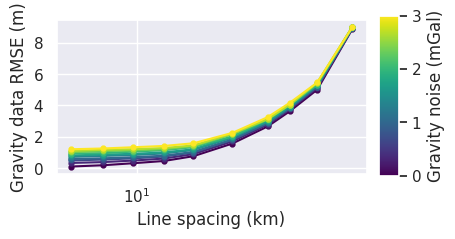

In [38]:
x = "grav_line_spacing"
fig = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(4, 2),
    x=x,
    x_label="Line spacing (km)",
    y="grav_data_loss_rmse",
    y_label="Gravity data RMSE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    logx=True,
)

In [39]:
# subplots showing grav data loss from sampling and noise
grids = []
cbar_labels = []
row_titles = []
column_titles = []
surveys = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"],
    ascending=False,
).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels, 1))
    # get survey points
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)
    surveys.append(grav_survey_df)

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Data loss from airborne surveying and noise",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    # fig_x_axis_title_y_offset="-2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    point_sets=surveys,
    points_style="p.02c",
)
fig.show()

In [40]:
# subplots showing true gravity and sampled-noisy gravity
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"], ascending=[False, True]
).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

    # dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly

    dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly

    # add to lists
    grids.append(grav_grid.gravity_anomaly_full_res_no_noise)
    grids.append(grav_grid.gravity_anomaly)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels, 1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2 * np.sqrt(len(df))),
    fig_height=8,
    fig_title="Low regional",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["viridis"] * 2 for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[
        x
        for xs in [
            [polar_utils.get_combined_min_max(grids, robust=True)] * 2
            for x in range(len(df))
        ]
        for x in xs
    ],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.show()

# Estimate and separate regional

In [41]:
def regional_comparison(df):
    # grid the results
    grav_grid = df.set_index(["northing", "easting"]).to_xarray()

    # compare with true regional
    _ = polar_utils.grd_compare(
        grav_grid.basement_grav,
        grav_grid.reg,
        plot=True,
        grid1_name="True regional misfit",
        grid2_name="Regional misfit",
        hist=True,
        cbar_yoffset=1,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
        points_style="x.3c",
    )

In [42]:
# estimate regional

# Eq sources is too slow for so many trials
# regional_grav_kwargs = dict(
#     method="constraints",
#     grid_method="eq_sources",
#     constraints_df=constraint_points,
#     cv=True,
#     cv_kwargs=dict(
#         n_trials=8,
#         # damping_limits=(1e-3, 10),
#         depth_limits=(100, 500e3),
#         progressbar=False,
#         # fname=ensemble_path+"_regional_sep",
#     ),
#     # depth="default",
#     damping=None,
#     block_size=None,
# )

# use pygmt to interpolate
regional_grav_kwargs = dict(
    method="constraints",
    grid_method="pygmt",
    constraints_df=constraint_points,
    tension_factor=0,
)

In [43]:
logging.getLogger().setLevel(logging.INFO)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # calculate the true residual misfit
    grav_df["true_res"] = (
        grav_df.gravity_anomaly - grav_df.starting_gravity - grav_df.basement_grav
    )

    grav_df = regional.regional_separation(
        grav_df=grav_df,
        **regional_grav_kwargs,
    )

    # resave gravity dataframe
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090


In [44]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [45]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090


In [46]:
for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "regional_error"] = utils.rmse(
        grav_df.basement_grav - grav_df.reg
    )
    sampled_params_df.loc[i, "residual_error"] = utils.rmse(
        grav_df.true_res - grav_df.res
    )
    sampled_params_df.loc[i, "regional_rms"] = utils.rmse(grav_df.basement_grav)

sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,0.814961,0.580565,1.580742,1.580742,40.913189
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,0.937147,0.658105,1.707479,1.707479,40.913189
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.016720,0.731753,1.750538,1.750538,40.913189
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.103661,0.809328,1.799147,1.799147,40.913189


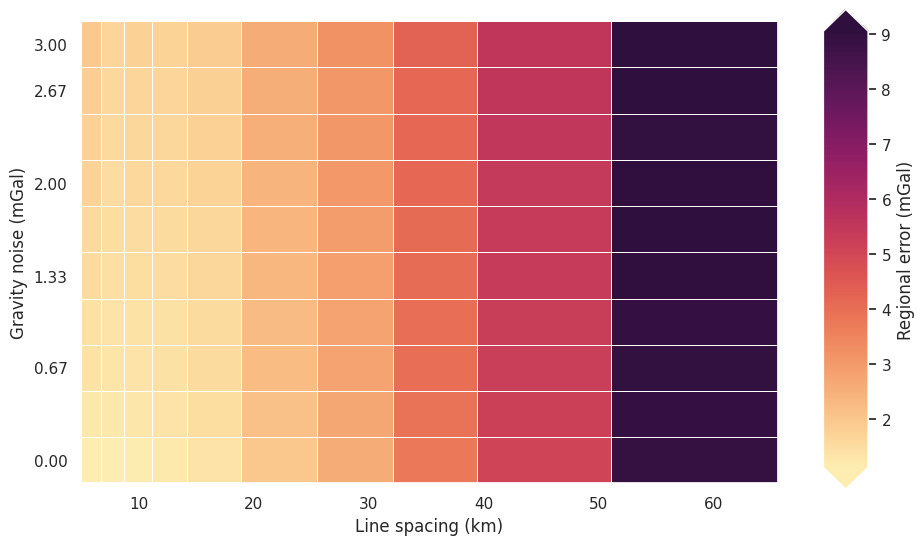

In [47]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="regional_error",
    background_title="Regional error (mGal)",
    constrained_layout=False,
)

In [48]:
# subplots showing regional gravity errors
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"],
    ascending=False,
).iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)
    grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
    dif = grav_grid.basement_grav - grav_grid.reg
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE:{round(utils.rmse(dif),2)}")
    if i % num == 0:
        column_titles.append(round(row.grav_line_spacing))
    if i < num:
        row_titles.append(round(row.grav_noise_levels, 1))

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Regional estimation error",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_x_axis_title="Line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(
        grids,
        robust=True,
        absolute=True,
    ),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

In [49]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [50]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189


# Inversion with true density contrast

In [7]:
for i, row in sampled_params_df.iterrows():
    # set results file name, add results file name
    sampled_params_df.loc[i, "true_density_results_fname"] = (
        f"{ensemble_path}_true_density_results_{i}"
    )
    sampled_params_df.loc[i, "true_density_inverted_bathymetry_fname"] = (
        f"{ensemble_path}_true_density_inverted_bathymetry_{i}.nc"
    )

<!-- # Damping Cross Validation -->

In [52]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = 0.2**0.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**0.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200,
        "l2_norm_tolerance": l2_norm_tolerance,  # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
        "solver_damping": 0.025,
    }

    # run the inversion workflow, including a cross validation for the damping parameter
    _ = inversion.run_inversion_workflow(
        grav_df=grav_df,
        starting_prisms=starting_prisms,
        fname=row.true_density_results_fname,
        **kwargs,
    )

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [8]:
for i, row in sampled_params_df.iterrows():
    # load saved inversion results
    with pathlib.Path(f"{row.true_density_results_fname}_results.pickle").open(
        "rb"
    ) as f:
        topo_results, grav_results, parameters, elapsed_time = pickle.load(f)

    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # sample the inverted topography at the constraint points
    constraint_points = utils.sample_grids(
        constraint_points,
        final_bathymetry,
        f"true_density_inverted_bathymetry_{i}",
        coord_names=("easting", "northing"),
    )
    constraints_rmse = utils.rmse(
        constraint_points.true_upward
        - constraint_points[f"true_density_inverted_bathymetry_{i}"]
    )

    # clip to inversion region
    final_bathymetry = final_bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )

    inversion_rmse = utils.rmse(bathymetry - final_bathymetry)

    # save final topography to file
    final_bathymetry.to_netcdf(row.true_density_inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "true_density_constraints_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "true_density_inversion_rmse"] = inversion_rmse

sampled_params_df.head()

NameError: name 'utils' is not defined

In [54]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [55]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901


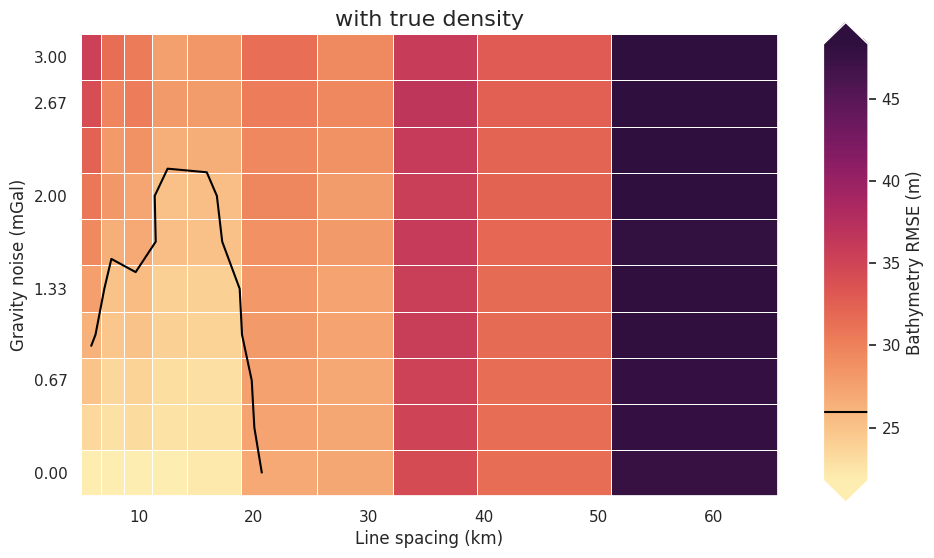

In [61]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="true_density_inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    constrained_layout=False,
    plot_title="with true density",
    # background_cpt_lims=[15,50],
)

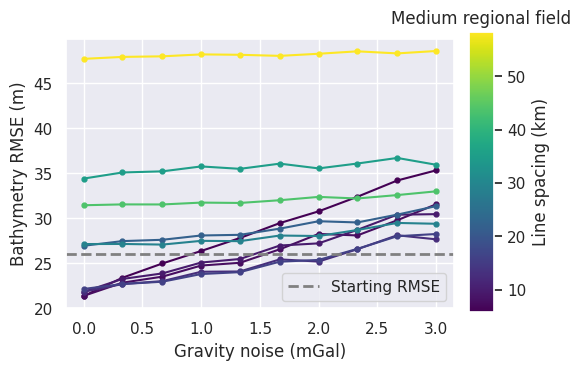

In [57]:
_ = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="true_density_inversion_rmse",
    x="grav_noise_levels",
    groupby_col="grav_line_spacing",
    x_label="Gravity noise (mGal)",
    cbar_label="Line spacing (km)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)

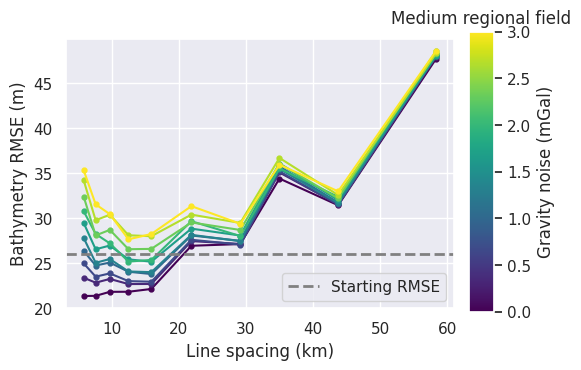

In [58]:
_ = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="true_density_inversion_rmse",
    x="grav_line_spacing",
    groupby_col="grav_noise_levels",
    x_label="Line spacing (km)",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)

# Density optimization

In [62]:
for i, row in sampled_params_df.iterrows():
    # add results file name
    sampled_params_df.loc[i, "density_estimation_results_fname"] = (
        f"{ensemble_path}_density_estimation_results_{i}"
    )
    sampled_params_df.loc[i, "density_estimation_inverted_bathymetry_fname"] = (
        f"{ensemble_path}_density_estimation_inverted_bathymetry_{i}.nc"
    )
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [63]:
for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = 0.2**0.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**0.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200,
        "l2_norm_tolerance": l2_norm_tolerance,  # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
        "solver_damping": 0.025,
    }

    # run an optimization to find the optimal density contrast
    # automatically reruns inversion with optimal density contrast
    # and saves the results to <fname>_results.pickle
    _, _ = optimization.optimize_inversion_zref_density_contrast(
        grav_df=grav_df,
        constraints_df=constraint_points,
        density_contrast_limits=(1400, 3300),
        zref=0,
        n_trials=8,
        starting_topography=starting_bathymetry,
        regional_grav_kwargs=dict(
            method="constant",
            constant=0,
        ),
        fname=row.density_estimation_results_fname,
        plot_cv=False,
        progressbar=False,
        **kwargs,
    )

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,8.904737,8.904737,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,8.950118,8.950118,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,8.977673,8.977673,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,8.945461,8.945461,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,8.989788,8.989788,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [64]:
for i, row in sampled_params_df.iterrows():
    # load study
    with pathlib.Path(f"{row.density_estimation_results_fname}_study.pickle").open(
        "rb"
    ) as f:
        study = pickle.load(f)

    # add best density to dataframe
    sampled_params_df.loc[i, "best_density_contrast"] = study.best_params[
        "density_contrast"
    ]

    # load saved inversion results
    with pathlib.Path(f"{row.density_estimation_results_fname}_results.pickle").open(
        "rb"
    ) as f:
        topo_results, grav_results, parameters, elapsed_time = pickle.load(f)

    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # sample the inverted topography at the constraint points
    constraint_points = utils.sample_grids(
        constraint_points,
        final_bathymetry,
        f"density_estimation_inverted_bathymetry_{i}",
        coord_names=("easting", "northing"),
    )
    constraints_rmse = utils.rmse(
        constraint_points.true_upward
        - constraint_points[f"density_estimation_inverted_bathymetry_{i}"]
    )

    # clip to inversion region
    final_bathymetry = final_bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )

    inversion_rmse = utils.rmse(bathymetry - final_bathymetry)

    # save final topography to file
    final_bathymetry.to_netcdf(row.density_estimation_inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "density_estimation_constraints_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "density_estimation_inversion_rmse"] = inversion_rmse

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname,best_density_contrast,density_estimation_constraints_rmse,density_estimation_inversion_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,565.874935,436.184637
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,564.941690,436.059852
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,556.256130,433.466431
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,574.160507,441.138972
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,573.685991,441.032281


In [65]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [66]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,regional_rms,true_density_results_fname,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname,best_density_contrast,density_estimation_constraints_rmse,density_estimation_inversion_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,565.874935,436.184637
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,564.941690,436.059852
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,556.256130,433.466431
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,574.160507,441.138972
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,40.913189,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,573.685991,441.032281


Text(0, 0.5, 'RMSE (m)')

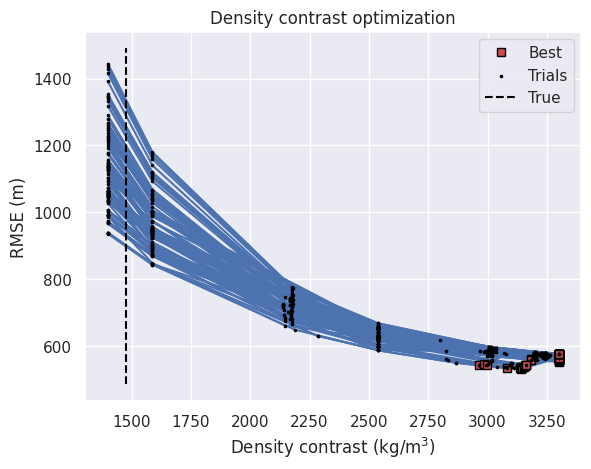

In [67]:
fig, ax = plt.subplots()

for i, row in sampled_params_df.iterrows():
    # load study
    with pathlib.Path(f"{row.density_estimation_results_fname}_study.pickle").open(
        "rb"
    ) as f:
        study = pickle.load(f)

    if i == 0:
        label = "Best"
        label_points = "Trials"
    else:
        label = None
        label_points = None

    study_df = study.trials_dataframe()
    # print(study_df)
    df = study_df[["value", "params_density_contrast"]].sort_values(
        by="params_density_contrast"
    )
    best_score = df.value.argmin()

    ax.plot(
        df.params_density_contrast.iloc[best_score],
        df.value.iloc[best_score],
        "s",
        markersize=6,
        color="r",
        label=label,
        zorder=10,
        markeredgecolor="black",
        linewidth=0.5,
    )
    ax.plot(
        df.params_density_contrast,
        df.value,
        # marker="o",
        color="b",
        # color=plt.cm.viridis(norm(row.grav_proximity)), # pylint: disable=no-member
    )
    ax.scatter(
        df.params_density_contrast,
        df.value,
        s=10,
        marker=".",
        color="black",
        edgecolors="black",
        zorder=10,
        label=label_points,
    )

ax.vlines(
    true_density_contrast,
    ax.get_ylim()[0],
    ax.get_ylim()[1],
    color="black",
    linestyle="--",
    label="True",
)
ax.legend(loc="best")
ax.set_title("Density contrast optimization")
ax.set_xlabel("Density contrast (kg/m$^3$)")
ax.set_ylabel("RMSE (m)")

# ax.set_xlim(true_density_contrast-100, true_density_contrast+100)
# ax.set_ylim(0, 100)

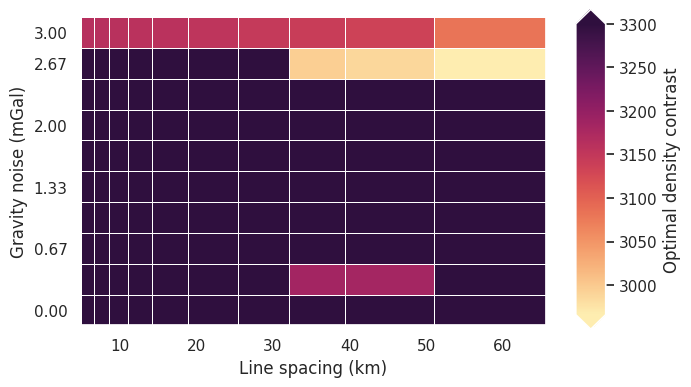

In [68]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    figsize=(6, 4),
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="best_density_contrast",
    background_title="Optimal density contrast",
    # background_robust=True,
    constrained_layout=False,
)

# Redo with optimal density


In [16]:
for i, row in sampled_params_df.iterrows():
    # add results file name
    sampled_params_df.loc[i, "final_inversion_fname"] = (
        f"{ensemble_path}_final_inversion_{i}"
    )
    sampled_params_df.loc[i, "final_inverted_bathymetry_fname"] = (
        f"{ensemble_path}_final_inverted_bathymetry_{i}.nc"
    )

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname,best_density_contrast,density_estimation_constraints_rmse,density_estimation_inversion_rmse,final_inversion_fname,final_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,565.874935,436.184637,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,564.941690,436.059852,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,556.256130,433.466431,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,574.160507,441.138972,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,573.685991,441.032281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [70]:
logging.getLogger().setLevel(logging.WARNING)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = 0.2**0.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**0.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200,
        "l2_norm_tolerance": l2_norm_tolerance,  # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
        "solver_damping": 0.025,
    }

    # run the inversion workflow using the optimal damping and density values
    _ = inversion.run_inversion_workflow(
        grav_df=grav_df,
        density_contrast=row.best_density_contrast,
        zref=0,
        starting_topography=starting_bathymetry,
        regional_grav_kwargs=regional_grav_kwargs,
        fname=row.final_inversion_fname,
        create_starting_prisms=True,
        calculate_starting_gravity=True,
        calculate_regional_misfit=True,
        **kwargs,
    )

sampled_params_df.head()

  0%|          | 0/100 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,true_density_inverted_bathymetry_fname,true_density_constraints_rmse,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname,best_density_contrast,density_estimation_constraints_rmse,density_estimation_inversion_rmse,final_inversion_fname,final_inverted_bathymetry_fname
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.822319,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,565.874935,436.184637,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.941441,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,564.941690,436.059852,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.904116,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,556.256130,433.466431,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.926282,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,574.160507,441.138972,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.839960,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,573.685991,441.032281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...


In [17]:
for i, row in sampled_params_df.iterrows():
    # load saved inversion results
    with pathlib.Path(f"{row.final_inversion_fname}_results.pickle").open("rb") as f:
        topo_results, grav_results, parameters, elapsed_time = pickle.load(f)

    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # sample the inverted topography at the constraint points
    constraint_points = utils.sample_grids(
        constraint_points,
        final_bathymetry,
        f"final_inverted_bathymetry_{i}",
        coord_names=("easting", "northing"),
    )
    constraints_rmse = utils.rmse(
        constraint_points.true_upward
        - constraint_points[f"final_inverted_bathymetry_{i}"]
    )

    # clip to inversion region
    final_bathymetry = final_bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )

    inversion_rmse = utils.rmse(bathymetry - final_bathymetry)

    # save final topography to file
    final_bathymetry.to_netcdf(row.final_inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "final_inversion_constraints_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "final_inversion_rmse"] = inversion_rmse

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,true_density_inversion_rmse,density_estimation_results_fname,density_estimation_inverted_bathymetry_fname,best_density_contrast,density_estimation_constraints_rmse,density_estimation_inversion_rmse,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,47.720292,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,565.874935,436.184637,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.466450,31.433144
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,47.939436,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,564.941690,436.059852,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.577196,31.543056
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,48.003070,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,556.256130,433.466431,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.534285,31.596929
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,48.218165,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,574.160507,441.138972,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.563067,31.679589
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,48.173901,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,3300.0,573.685991,441.032281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.480156,31.699064


# Examine results

In [18]:
# subplots showing inverted bathymetry error
grids = []
cbar_labels = []
row_titles = []
column_titles = []

# iterate over the ensemble starting with high noise, low line numbers
# row per noise level and column per line spacing
for i, row in sampled_params_df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"],
    ascending=False,
).iterrows():
    dif = bathymetry - xr.open_dataarray(row.final_inverted_bathymetry_fname)
    # add to lists
    grids.append(dif)
    cbar_labels.append(f"RMSE: {round(utils.rmse(dif),2)} (mGal)")
    if i % num == 0:
        column_titles.append(f"Spacing: {round(row.grav_line_spacing)} km")
    if i < num:
        row_titles.append(f"Noise: {round(row.grav_noise_levels,1)} mGal")

fig = maps.subplots(
    grids,
    fig_height=8,
    fig_title="Inverted bathymetry error",
    fig_title_font="75p,Helvetica-Bold,black",
    fig_title_y_offset="5c",
    cbar_labels=cbar_labels,
    cmap="balance+h0",
    # hist=True,
    cpt_lims=polar_utils.get_combined_min_max(
        grids,
        robust=True,
        absolute=True,
    ),
    cbar_font="18p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="25p,Helvetica,black",
    column_titles_font="25p,Helvetica,black",
)
fig.show()

In [31]:
sampled_params_df["residual_error"] = pd.Series()

for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "residual_error"] = utils.rmse(
        grav_df.true_res - grav_df.res
    )

sampled_params_df["final_inversion_topo_improvement_rmse"] = (
    starting_bathymetry_rmse - sampled_params_df.final_inversion_rmse
)

sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,density_estimation_inversion_rmse,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,topo_improvement_rmse,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density,final_inversion_topo_improvement_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,436.184637,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.466450,31.433144,-5.455781,1050.0,350.0,-16.287148,-5.455781
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,436.059852,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.577196,31.543056,-5.565693,1050.0,350.0,-16.396380,-5.565693
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,433.466431,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.534285,31.596929,-5.619566,1050.0,350.0,-16.406141,-5.619566
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,441.138972,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.563067,31.679589,-5.702226,1050.0,350.0,-16.538576,-5.702226
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,441.032281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.480156,31.699064,-5.721701,1050.0,350.0,-16.474837,-5.721701
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,0.814961,0.580565,...,452.896643,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,4.380261,17.914354,8.063009,10500.0,3500.0,-11.529760,8.063009
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,0.937147,0.658105,...,452.591598,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.098610,19.237112,6.740250,10500.0,3500.0,-11.512339,6.740250
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.016720,0.731753,...,452.636281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.282735,20.249663,5.727700,10500.0,3500.0,-12.120846,5.727700
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.103661,0.809328,...,452.689067,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.484598,21.381932,4.595431,10500.0,3500.0,-12.802677,4.595431


<!-- ## Density CV -->

In [20]:
w = np.abs(inversion_region[1] - inversion_region[0]) / 1e3
h = np.abs(inversion_region[3] - inversion_region[2]) / 1e3
w, h

(150.0, 200.0)

In [21]:
sampled_params_df["flight_kms"] = pd.Series()
for i, row in sampled_params_df.iterrows():
    survey_df = pd.read_csv(row.grav_survey_df_fname)
    # flight km is length of lines in km X number of lines
    sampled_params_df.loc[i, "flight_kms"] = (
        w * row.grav_line_numbers + h * row.grav_line_numbers
    )
sampled_params_df.flight_kms.unique()

array([1050.0, 1400.0, 1750.0, 2100.0, 2800.0, 3850.0, 4900.0, 6300.0,
       8050.0, 10500.0], dtype=object)

In [22]:
inversion_area = (
    (inversion_region[1] - inversion_region[0])
    / 1e3
    * (inversion_region[3] - inversion_region[2])
    / 1e3
)
sampled_params_df["flight_kms_per_10000sq_km"] = (
    (sampled_params_df.flight_kms / inversion_area) * 10e3
).astype(float)
sampled_params_df.flight_kms_per_10000sq_km.unique()

array([ 350.        ,  466.66666667,  583.33333333,  700.        ,
        933.33333333, 1283.33333333, 1633.33333333, 2100.        ,
       2683.33333333, 3500.        ])

In [37]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [33]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_proximity,filter_width_trials_fname,best_filter_width,grav_data_loss_rmse,grav_data_loss_mae,...,density_estimation_inversion_rmse,final_inversion_fname,final_inverted_bathymetry_fname,final_inversion_constraints_rmse,final_inversion_rmse,topo_improvement_rmse,flight_kms,flight_kms_per_10000sq_km,inversion_rmse_dif_true_vs_optimal_density,final_inversion_topo_improvement_rmse
0,3,0.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,0.0,8.878804,5.425894,...,436.184637,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.466450,31.433144,-5.455781,1050.0,350.0,-16.287148,-5.455781
1,3,0.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,8000.0,8.922980,5.461194,...,436.059852,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.577196,31.543056,-5.565693,1050.0,350.0,-16.396380,-5.565693
2,3,0.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.950887,5.496941,...,433.466431,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.534285,31.596929,-5.619566,1050.0,350.0,-16.406141,-5.619566
3,3,1.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,12000.0,8.922696,5.498062,...,441.138972,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.563067,31.679589,-5.702226,1050.0,350.0,-16.538576,-5.702226
4,3,1.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,58.333333,8.333333,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,8.965989,5.548090,...,441.032281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,1.480156,31.699064,-5.721701,1050.0,350.0,-16.474837,-5.721701
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,30,1.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,16000.0,0.814961,0.580565,...,452.896643,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,4.380261,17.914354,8.063009,10500.0,3500.0,-11.529760,8.063009
96,30,2.00,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,0.937147,0.658105,...,452.591598,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.098610,19.237112,6.740250,10500.0,3500.0,-11.512339,6.740250
97,30,2.33,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.016720,0.731753,...,452.636281,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.282735,20.249663,5.727700,10500.0,3500.0,-12.120846,5.727700
98,30,2.67,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.833333,0.824621,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,20000.0,1.103661,0.809328,...,452.689067,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,../results/Ross_Sea/ensembles/Ross_Sea_ensembl...,5.484598,21.381932,4.595431,10500.0,3500.0,-12.802677,4.595431


In [35]:
sampled_params_df = sampled_params_df.drop(columns=["topo_improvement_rmse"])

In [36]:
sampled_params_df.columns

Index(['grav_line_numbers', 'grav_noise_levels', 'grav_df_fname',
       'grav_survey_df_fname', 'grav_line_spacing', 'grav_proximity',
       'filter_width_trials_fname', 'best_filter_width', 'grav_data_loss_rmse',
       'grav_data_loss_mae', 'regional_error', 'residual_error',
       'regional_rms', 'true_density_results_fname',
       'true_density_inverted_bathymetry_fname',
       'true_density_constraints_rmse', 'true_density_inversion_rmse',
       'density_estimation_results_fname',
       'density_estimation_inverted_bathymetry_fname', 'best_density_contrast',
       'density_estimation_constraints_rmse',
       'density_estimation_inversion_rmse', 'final_inversion_fname',
       'final_inverted_bathymetry_fname', 'final_inversion_constraints_rmse',
       'final_inversion_rmse', 'flight_kms', 'flight_kms_per_10000sq_km',
       'inversion_rmse_dif_true_vs_optimal_density',
       'final_inversion_topo_improvement_rmse'],
      dtype='object')

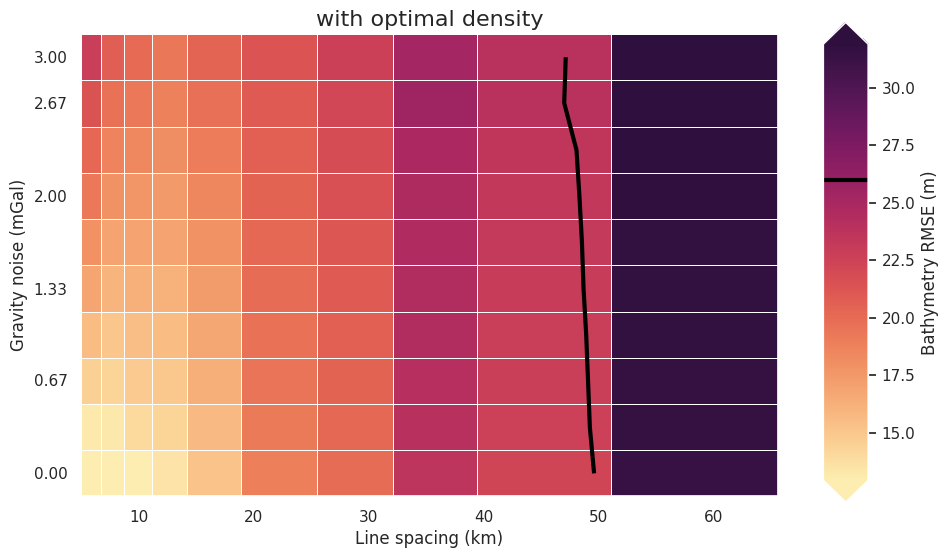

In [26]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="final_inversion_rmse",
    background_title="Bathymetry RMSE (m)",
    background_robust=True,
    plot_contours=[starting_bathymetry_rmse],
    plot_title="with optimal density",
    constrained_layout=False,
)

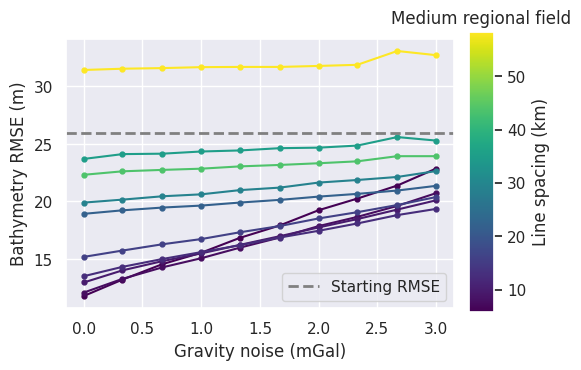

In [27]:
_ = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="final_inversion_rmse",
    x="grav_noise_levels",
    groupby_col="grav_line_spacing",
    x_label="Gravity noise (mGal)",
    cbar_label="Line spacing (km)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)

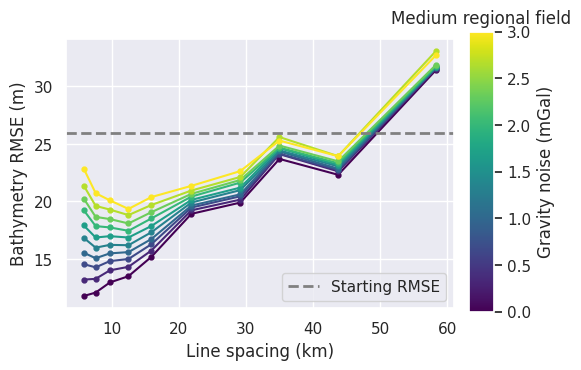

In [28]:
_ = synth_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="final_inversion_rmse",
    x="grav_line_spacing",
    groupby_col="grav_noise_levels",
    x_label="Line spacing (km)",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="Medium regional field",
)

count    100.000000
mean      -9.785585
std        2.626846
min      -16.676080
25%      -10.822480
50%       -9.217563
75%       -8.226734
max       -6.362964
Name: inversion_rmse_dif_true_vs_optimal_density, dtype: float64

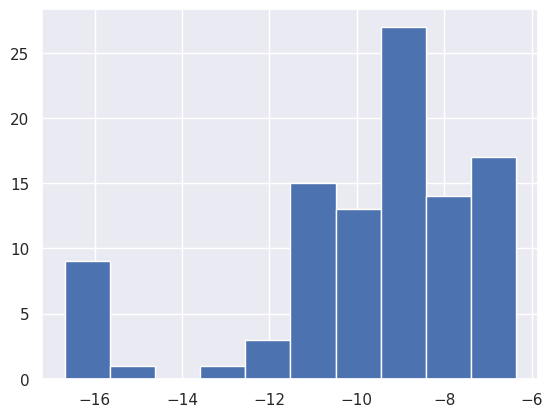

In [29]:
# difference with true and optimal bathymetry
sampled_params_df["inversion_rmse_dif_true_vs_optimal_density"] = (
    sampled_params_df.final_inversion_rmse
    - sampled_params_df.true_density_inversion_rmse
)
sampled_params_df.inversion_rmse_dif_true_vs_optimal_density.hist()
sampled_params_df.inversion_rmse_dif_true_vs_optimal_density.describe()

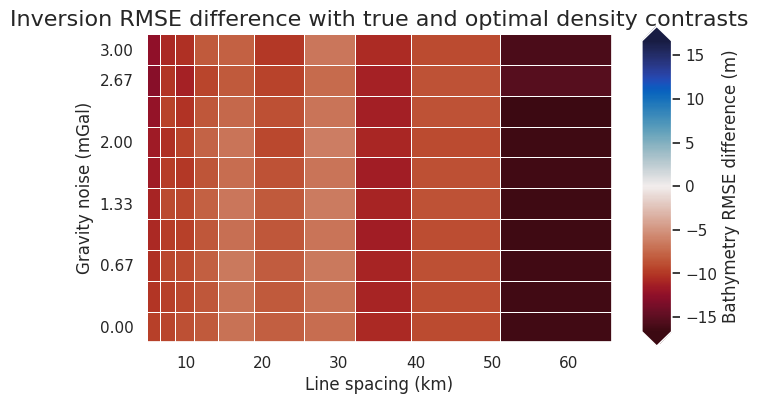

In [30]:
fig = synth_plotting.plot_2var_ensemble(
    sampled_params_df,
    figsize=(6, 4),
    x="grav_line_spacing",
    y="grav_noise_levels",
    x_title="Line spacing (km)",
    y_title="Gravity noise (mGal)",
    background="inversion_rmse_dif_true_vs_optimal_density",
    background_title="Bathymetry RMSE difference (m)",
    background_cmap="cmo.balance_r",
    background_cpt_lims=polar_utils.get_min_max(
        sampled_params_df.inversion_rmse_dif_true_vs_optimal_density,
        # robust=True,
        absolute=True,
    ),
    # logx=True,
    # flipx=True,
    constrained_layout=False,
    plot_title="Inversion RMSE difference with true and optimal density contrasts",
)